<div style="background-color:#ffe4de; padding: 20px; border-radius: 10px; box-shadow: 0 2px 4px 0 rgba(0, 0, 0, 0.1);">
    <h1 style="font-size:24px; font-family:calibri; color:#ed2f00;"><b>Codelords - pothole detection and segmentation</b></h1>
    <p style="font-size:20px; font-family:calibri; line-height: 1.5em; text-indent: 20px;"> <strong>Thabo Maibi : </strong> 23141360 </p>
</div>

In [1]:
!pip install roboflow

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 79.1/79.1 kB 1.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 54.5/54.5 kB 2.6 MB/s eta 0:00:00


In [2]:
# Disable warnings in the notebook to maintain clean output cells
import warnings
warnings.filterwarnings('ignore')
from google.colab import drive
drive.mount('/content/drive')

# Import necessary libraries
import os
import shutil
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import random
import cv2
from roboflow import Roboflow
from PIL import Image
from collections import deque
from IPython.display import Video

# Path to the folder containing the CSV files in Google Drive
patch_data_path = '/content/drive/My Drive/Patch_Perfect_Data/'
supplementary_dataset_path = '/content/drive/My Drive/Supplementary_Data/'
pothole_dataset_path = '/content/drive/My Drive/pothole_data/'

Mounted at /content/drive


In [3]:
# Configure the visual appearance of Seaborn plots
sns.set(rc={'axes.facecolor': '#ffe4de'}, style='darkgrid')

#Loading Pothole detection model from roboflow

In [4]:
rf = Roboflow(api_key="8eu0AXvuYsVZBGEZHazo")
project = rf.workspace().project("pothole-segmentation-o1kix")
model = project.version("3").model
#testing
#model.infer(image="YOUR_IMAGE.jpg")

loading Roboflow workspace...
loading Roboflow project...


#Provided data exploration

In [5]:
# Set paths for training and validation image sets
train_patch_image = os.path.join(patch_data_path, 'train_images', 'train_images')
valid_patch_image = os.path.join(patch_data_path, 'test_images', 'test_images')

# Initialize counters for the number of images
num_train_patch_images = 0
num_valid_patch_images = 0

# Initialize sets to hold the unique sizes of images
train_patch_image_sizes = set()
valid_patch_image_sizes = set()

# Check train images sizes and count
for filename in os.listdir(train_patch_image):
    if filename.endswith('.jpg'):
        num_train_patch_images += 1
        image_path = os.path.join(train_patch_image, filename)
        with Image.open(image_path) as img:
            train_patch_image_sizes.add(img.size)

# Check validation images sizes and count
for filename in os.listdir(valid_patch_image):
    if filename.endswith('.jpg'):
        num_valid_patch_images += 1
        image_path = os.path.join(valid_patch_image, filename)
        with Image.open(image_path) as img:
            valid_patch_image_sizes.add(img.size)

# Print the results
print(f"Number of training images from provided dataset: {num_train_patch_images}")
print(f"Number of validation images from provided dataset: {num_valid_patch_images}")

# Check if all images in training set have the same size
if len(train_patch_image_sizes) == 1:
    print(f"All training images have the same size: {train_patch_image_sizes.pop()}")
else:
    print("Training images have varying sizes.")

# Check if all images in validation set have the same size
if len(valid_patch_image_sizes) == 1:
    print(f"All validation images have the same size: {valid_patch_image_sizes.pop()}")
else:
    print("Validation images have varying sizes.")

Number of training images from provided dataset: 485
Number of validation images from provided dataset: 30
Training images have varying sizes.
Validation images have varying sizes.


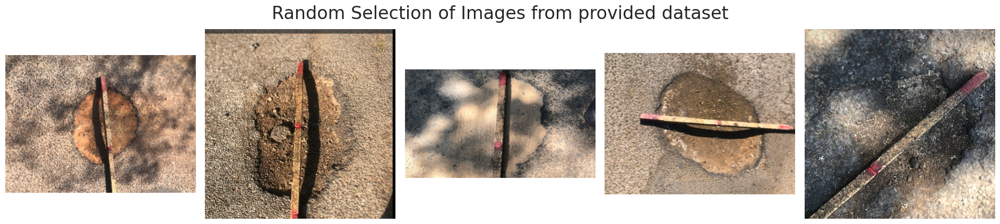

In [6]:
# Set the seed for the random number generator
random.seed(0)

# Create a list of image files
image_files = [f for f in os.listdir(train_patch_image) if f.endswith('.jpg')]

# Randomly select 15 images
random_images = random.sample(image_files, 5)

# Create a new figure
plt.figure(figsize=(19, 12))

# Loop through each image and display it in a 3x5 grid
for i, image_file in enumerate(random_images):
    image_path = os.path.join(train_patch_image, image_file)
    image = Image.open(image_path)
    plt.subplot(3, 5, i + 1)
    plt.imshow(image)
    plt.axis('off')

# Add a suptitle
plt.suptitle('Random Selection of Images from provided dataset', fontsize=24)

# Show the plot
plt.tight_layout()
plt.show()

# Deleting unnecessary variable to free up memory
del image_files

#Supplementary dataset

In [ ]:
# Set paths for training and validation image sets
train_supplementary_image = os.path.join(supplementary_dataset_path, 'train_images_2', 'potholes_images_jpegs2')

# Initialize counters for the number of images
num_train_supplementary_images = 0

# Initialize sets to hold the unique sizes of images
train_supplementary_image_sizes = set()

# Check train images sizes and count
for filename in os.listdir(train_supplementary_image):
    if filename.endswith('.jpg'):
        num_train_supplementary_images += 1
        image_path = os.path.join(train_supplementary_image, filename)
        with Image.open(image_path) as img:
            train_supplementary_image_sizes.add(img.size)


# Print the results
print(f"Number of training images from supplementary dataset: {num_train_supplementary_images}")

# Check if all images in training set have the same size
if len(train_supplementary_image_sizes) == 1:
    print(f"All supplementary training images have the same size: {train_supplementary_image_sizes.pop()}")
else:
    print("supplementary Training images have varying sizes.")

**2. For supplementary data**

In [10]:
# Set paths for training and validation image sets
train_supplementary_image = os.path.join(supplementary_dataset_path, 'train_images_2', 'potholes_images_jpegs2')

# Initialize counters for the number of images
num_train_supplementary_images = 0

# Initialize sets to hold the unique sizes of images
train_supplementary_image_sizes = set()

# Check train images sizes and count
for filename in os.listdir(train_supplementary_image):
    if filename.endswith('.jpg'):
        num_train_supplementary_images += 1
        image_path = os.path.join(train_supplementary_image, filename)
        with Image.open(image_path) as img:
            train_supplementary_image_sizes.add(img.size)


# Print the results
print(f"Number of training images from supplementary dataset: {num_train_supplementary_images}")

# Check if all images in training set have the same size
if len(train_supplementary_image_sizes) == 1:
    print(f"All supplementary training images have the same size: {train_supplementary_image_sizes.pop()}")
else:
    print("supplementary Training images have varying sizes.")



Number of training images from supplementary dataset: 493
supplementary Training images have varying sizes.


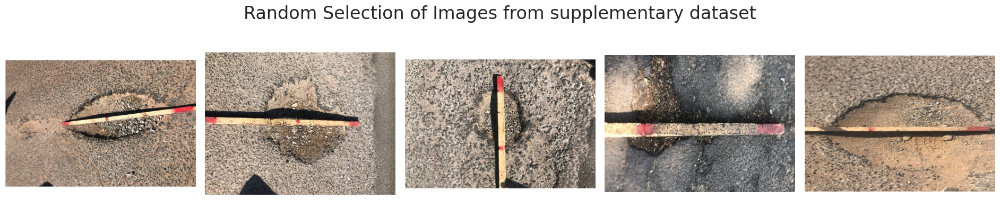

In [11]:
# Set the seed for the random number generator
random.seed(0)

# Create a list of image files
image_files = [f for f in os.listdir(train_supplementary_image) if f.endswith('.jpg')]

# Randomly select 15 images
random_images = random.sample(image_files, 5)

# Create a new figure
plt.figure(figsize=(19, 12))

# Loop through each image and display it in a 3x5 grid
for i, image_file in enumerate(random_images):
    image_path = os.path.join(train_supplementary_image, image_file)
    image = Image.open(image_path)
    plt.subplot(3, 5, i + 1)
    plt.imshow(image)
    plt.axis('off')

# Add a suptitle
plt.suptitle('Random Selection of Images from supplementary dataset', fontsize=24)

# Show the plot
plt.tight_layout()
plt.show()

# Deleting unnecessary variable to free up memory
del image_files

#Detect and segment potholes in all images

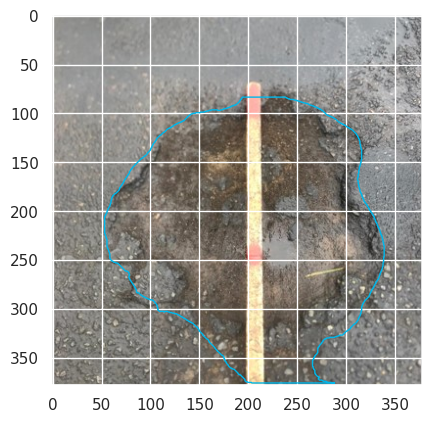

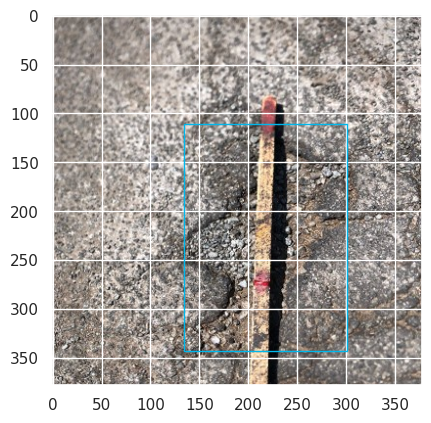

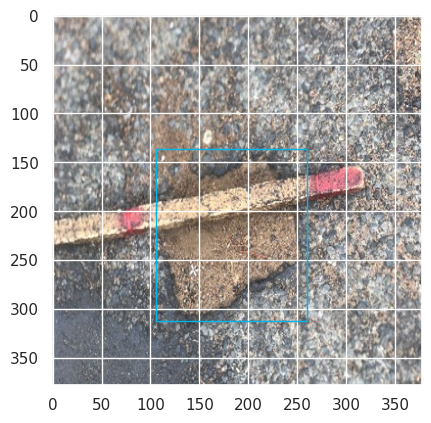

<Figure size 1900x1200 with 0 Axes>

In [12]:
# Set the seed for the random number generator
random.seed(123)

# Create a list of image files
image_files = [f for f in os.listdir(train_patch_image) if f.endswith('.jpg')]

# Randomly select 5 images
random_images = random.sample(image_files, 3)
# Predict results for each selected image
results = [model.predict(os.path.join(train_patch_image, image_file)) for image_file in random_images]


# Create a figure with subplots
annotated_images = [result[0].plot() for result in results]

annotated_images = [np.array(img) if isinstance(img, Image.Image) else img for img in annotated_images]

# Convert any PIL images to numpy arrays
annotated_images = [
    np.array(img) if isinstance(img, Image.Image) else np.array(img)
    for img in annotated_images
    if img is not None  # Filter out None values
]

# Create a new figure
plt.figure(figsize=(19, 12))

# Loop through each image and display it in a 1x5 grid (since there are 5 images)
for idx, img in enumerate(annotated_images):
    plt.subplot(1, 5, idx + 1)
    if img.dtype in [np.float32, np.float64, np.uint8]:  # Ensure the dtype is correct
        plt.imshow(img)
    else:
        plt.imshow(np.array(img, dtype=np.uint8))  # Convert to uint8 if needed
    plt.axis('off')

# Add a suptitle
plt.suptitle('Testing the pothole detection model', fontsize=24)

# Show the plot
plt.tight_layout()
plt.show()


#Testing model perfomance on external dataset

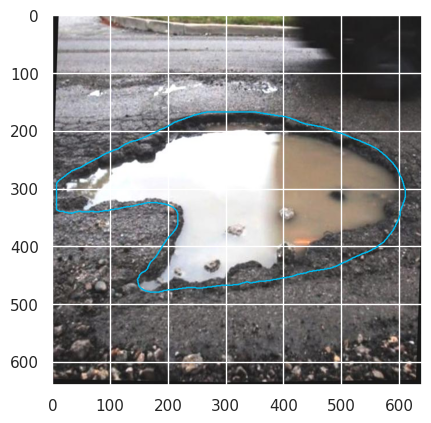

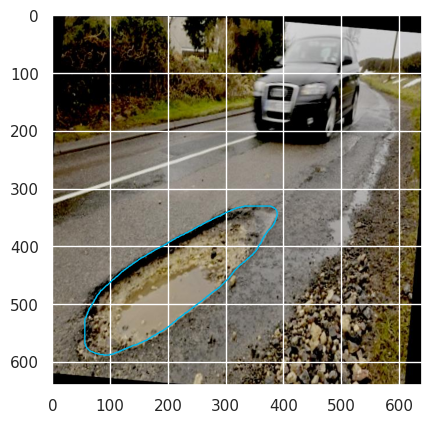

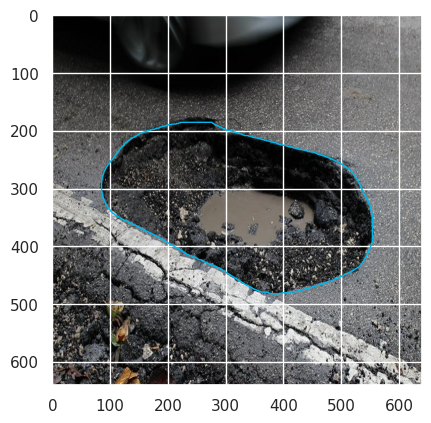

<Figure size 1900x1200 with 0 Axes>

In [13]:
outsourced_data_image = os.path.join(pothole_dataset_path, 'outsourced')
# Set the seed for the random number generator
random.seed(123)

# Create a list of image files
image_files = [f for f in os.listdir(outsourced_data_image) if f.endswith('.jpg')]

# Randomly select 5 images
random_images = random.sample(image_files, 3)
# Predict results for each selected image
results = [model.predict(os.path.join(outsourced_data_image, image_file),confidence=40) for image_file in random_images]


# Create a figure with subplots
annotated_images = [result[0].plot() for result in results]

annotated_images = [np.array(img) if isinstance(img, Image.Image) else img for img in annotated_images]

# Convert any PIL images to numpy arrays
annotated_images = [
    np.array(img) if isinstance(img, Image.Image) else np.array(img)
    for img in annotated_images
    if img is not None  # Filter out None values
]

# Create a new figure
plt.figure(figsize=(19, 12))

# Loop through each image and display it in a 1x5 grid (since there are 5 images)
for idx, img in enumerate(annotated_images):
    plt.subplot(1, 5, idx + 1)
    if img.dtype in [np.float32, np.float64, np.uint8]:  # Ensure the dtype is correct
        plt.imshow(img)
    else:
        plt.imshow(np.array(img, dtype=np.uint8))  # Convert to uint8 if needed
    plt.axis('off')

# Add a suptitle
plt.suptitle('Testing the pothole detection model', fontsize=24)

# Show the plot
plt.tight_layout()
plt.show()


#Creating new dataset of images with potholes segmentation

In [ ]:
def process_and_save_images(model, input_dir, output_dir):
    # Loop through all files in the input directory
    for filename in os.listdir(input_dir):
        if filename.endswith('.jpg') or filename.endswith('.png'):  # Adjust for other image formats if necessary
            input_path = os.path.join(input_dir, filename)
            output_path = os.path.join(output_dir, filename)
            # Process the image using the model (replace model.predict with the actual method if different)
            result = model.predict(input_path)

            for prediction in result:
                # Load the image
                image = cv2.imread(input_path)

                # Extract and prepare points
                points = prediction["points"]
                np_points = np.array([(p["x"], p["y"]) for p in points], np.int32)
                np_points = np_points.reshape((-1, 1, 2))  # Reshape for polylines

                # Draw the boundary with a green line
                cv2.polylines(image, [np_points], isClosed=True, color=(0, 255, 0), thickness=2)

                # Save the processed image to the output directory
                cv2.imwrite(output_path, image)

**1. For provided data**

In [15]:
#define output directories
output_dir_test = os.path.join(pothole_dataset_path, 'test')
output_dir_train = os.path.join(pothole_dataset_path, 'train')

#process and save new images
# process_and_save_images(model, valid_patch_image, output_dir_test)
# process_and_save_images(model, train_patch_image, output_dir_train)

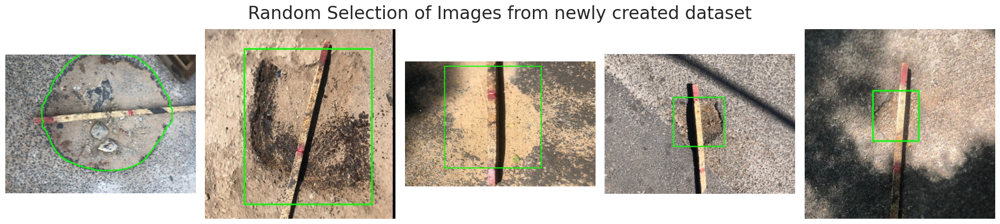

In [16]:
# Set the seed for the random number generator
random.seed(0)

# Create a list of image files
image_files = [f for f in os.listdir(output_dir_train) if f.endswith('.jpg')]

# Randomly select 15 images
random_images = random.sample(image_files, 5)

# Create a new figure
plt.figure(figsize=(19, 12))

# Loop through each image and display it in a 3x5 grid
for i, image_file in enumerate(random_images):
    image_path = os.path.join(output_dir_train, image_file)
    image = Image.open(image_path)
    plt.subplot(3, 5, i + 1)
    plt.imshow(image)
    plt.axis('off')

# Add a suptitle
plt.suptitle('Random Selection of Images from newly created dataset', fontsize=24)

# Show the plot
plt.tight_layout()
plt.show()

# Deleting unnecessary variable to free up memory
del image_files

**2. For supplementary data**

In [17]:
#define output directories
output_dir_supplementary_train = os.path.join(pothole_dataset_path, 'supplementary')


In [ ]:
#process and save new images
# process_and_save_images(model, train_supplementary_image, output_dir_supplementary_train)

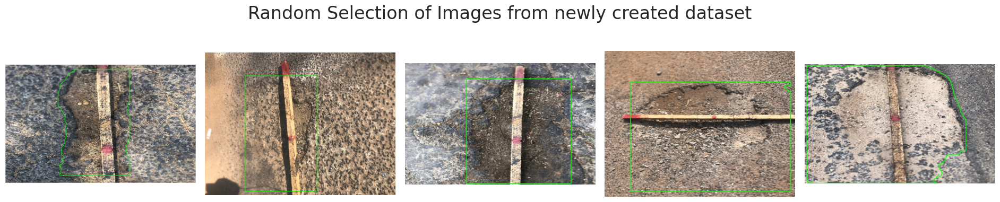

In [18]:
# Set the seed for the random number generator
random.seed(5)

# Create a list of image files
image_files = [f for f in os.listdir(output_dir_supplementary_train) if f.endswith('.jpg')]

# Randomly select 15 images
random_images = random.sample(image_files, 5)

# Create a new figure
plt.figure(figsize=(19, 12))

# Loop through each image and display it in a 3x5 grid
for i, image_file in enumerate(random_images):
    image_path = os.path.join(output_dir_supplementary_train, image_file)
    image = Image.open(image_path)
    plt.subplot(3, 5, i + 1)
    plt.imshow(image)
    plt.axis('off')

# Add a suptitle
plt.suptitle('Random Selection of Images from newly created dataset', fontsize=24)

# Show the plot
plt.tight_layout()
plt.show()

# Deleting unnecessary variable to free up memory
del image_files

#Inference on a Test Video

In [ ]:
# Define the path to the sample video in the dataset
dataset_video_path = '/content/drive/My Drive/Patch_Perfect_Data/sample_video.mp4'

# Define the destination path in the working directory
video_path = '/content/drive/My Drive/Patch_Perfect_Data/sample_video.mp4'


shutil.copyfile(dataset_video_path, video_path)

model.predict(source=video_path, save=True)

In [ ]:

!ffmpeg -y -loglevel panic -i /predict/sample_video.avi processed_sample_video.mp4

# Embed and display the processed sample video within the notebook
Video("processed_sample_video.mp4", embed=True, width=960)

# Real-Time Road Damage Assessment

In [ ]:
# Define the video path
video_path = '/content/drive/My Drive/Patch_Perfect_Data/sample_video.mp4'

# Define font, scale, colors, and position for the annotation
font = cv2.FONT_HERSHEY_SIMPLEX
font_scale = 1
text_position = (40, 80)
font_color = (255, 255, 255)    # White color for text
background_color = (0, 0, 255)  # Red background for text

# Initialize a deque with fixed length for averaging the last 10 percentage damages
damage_deque = deque(maxlen=10)

# Open the video
cap = cv2.VideoCapture(video_path)

# Define the codec and create VideoWriter object
fourcc = cv2.VideoWriter_fourcc(*'XVID')
out = cv2.VideoWriter('road_damage_assessment.avi', fourcc, 20.0, (int(cap.get(3)), int(cap.get(4))))

# Read until video is completed
while cap.isOpened():
     # Capture frame-by-frame
    ret, frame = cap.read()
    if ret:
        # Perform inference on the frame
        results = model.predict(source=frame, imgsz=640, conf=0.25)
        processed_frame = results[0].plot(boxes=False)

        # Initializes percentage_damage to 0
        percentage_damage = 0

        # If masks are available, calculate total damage area and percentage
        if results[0].masks is not None:
            total_area = 0
            masks = results[0].masks.data.cpu().numpy()
            image_area = frame.shape[0] * frame.shape[1]  # total number of pixels in the image
            for mask in masks:
                binary_mask = (mask > 0).astype(np.uint8) * 255
                contour, _ = cv2.findContours(binary_mask, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
                total_area += cv2.contourArea(contour[0])

            percentage_damage = (total_area / image_area) * 100

        # Calculate and update the percentage damage
        damage_deque.append(percentage_damage)
        smoothed_percentage_damage = sum(damage_deque) / len(damage_deque)

        # Draw a thick line for text background
        cv2.line(processed_frame, (text_position[0], text_position[1] - 10),
                 (text_position[0] + 350, text_position[1] - 10), background_color, 40)

        # Annotate the frame with the percentage of damage
        cv2.putText(processed_frame, f'Road Damage: {smoothed_percentage_damage:.2f}%', text_position, font, font_scale, font_color, 2, cv2.LINE_AA)

        # Write the processed frame to the output video
        out.write(processed_frame)
    else:
        break

# Release the video capture and video write objects
cap.release()
out.release()

# Close all the frames
# cv2.destroyAllWindows()


0: 384x640 1 Pothole, 12.7ms
Speed: 2.4ms preprocess, 12.7ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 11.6ms
Speed: 1.9ms preprocess, 11.6ms inference, 0.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 Pothole, 11.2ms
Speed: 1.7ms preprocess, 11.2ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 Pothole, 11.1ms
Speed: 1.6ms preprocess, 11.1ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 11.5ms
Speed: 1.7ms preprocess, 11.5ms inference, 0.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 12.8ms
Speed: 1.8ms preprocess, 12.8ms inference, 0.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 Potholes, 10.8ms
Speed: 1.4ms preprocess, 10.8ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 Pothole, 10.9ms
Speed: 1.4ms preprocess, 10.9ms inference, 1.7ms postprocess p

In [ ]:

!ffmpeg -y -loglevel panic -i /Drive/working/road_damage_assessment.avi road_damage_assessment.mp4

# Embed and display the processed sample video within the notebook
Video("road_damage_assessment.mp4", embed=True, width=960)